<div style="width:100%; height:140px">
    <img src="https://www.kuleuven.be/internationaal/thinktank/fotos-en-logos/ku-leuven-logo.png/image_preview" width = 300px, heigh = auto align=left>
</div>


KUL H02A5a Computer Vision: Group Assignment 2
---------------------------------------------------------------
Student numbers: <span style="color:red">r1, r2, r3, r4, r5</span>. (fill in your student numbers!)

In this group assignment your team will delve into some deep learning applications for computer vision. The assignment will be delivered in the same groups from *Group assignment 1* and you start from this template notebook. The notebook you submit for grading is the last notebook you submit in the [Kaggle competition](https://www.kaggle.com/t/d11be6a431b84198bc85f54ae7e2563f) prior to the deadline on **Tuesday 24 May 23:59**. Closely follow [these instructions](https://github.com/gourie/kaggle_inclass) for joining the competition, sharing your notebook with the TAs and making a valid notebook submission to the competition. A notebook submission not only produces a *submission.csv* file that is used to calculate your competition score, it also runs the entire notebook and saves its output as if it were a report. This way it becomes an all-in-one-place document for the TAs to review. As such, please make sure that your final submission notebook is self-contained and fully documented (e.g. provide strong arguments for the design choices that you make). Most likely, this notebook format is not appropriate to run all your experiments at submission time (e.g. the training of CNNs is a memory hungry and time consuming process; due to limited Kaggle resources). It can be a good idea to distribute your code otherwise and only summarize your findings, together with your final predictions, in the submission notebook. For example, you can substitute experiments with some text and figures that you have produced "offline" (e.g. learning curves and results on your internal validation set or even the test set for different architectures, pre-processing pipelines, etc). We advise you to first go through the PDF of this assignment entirely before you really start. Then, it can be a good idea to go through this notebook and use it as your first notebook submission to the competition. You can make use of the *Group assignment 2* forum/discussion board on Toledo if you have any questions. Good luck and have fun!

---------------------------------------------------------------
NOTES:
* This notebook is just a template. Please keep the five main sections, but feel free to adjust further in any way you please!
* Clearly indicate the improvements that you make! You can for instance use subsections like: *3.1. Improvement: applying loss function f instead of g*.


# 1. Overview
This assignment consists of *three main parts* for which we expect you to provide code and extensive documentation in the notebook:
* Image classification (Sect. 2)
* Semantic segmentation (Sect. 3)
* Adversarial attacks (Sect. 4)

In the first part, you will train an end-to-end neural network for image classification. In the second part, you will do the same for semantic segmentation. For these two tasks we expect you to put a significant effort into optimizing performance and as such competing with fellow students via the Kaggle competition. In the third part, you will try to find and exploit the weaknesses of your classification and/or segmentation network. For the latter there is no competition format, but we do expect you to put significant effort in achieving good performance on the self-posed goal for that part. Finally, we ask you to reflect and produce an overall discussion with links to the lectures and "real world" computer vision (Sect. 5). It is important to note that only a small part of the grade will reflect the actual performance of your networks. However, we do expect all things to work! In general, we will evaluate the correctness of your approach and your understanding of what you have done that you demonstrate in the descriptions and discussions in the final notebook.

## 1.1 Deep learning resources
If you did not yet explore this in *Group assignment 1 (Sect. 2)*, we recommend using the TensorFlow and/or Keras library for building deep learning models. You can find a nice crash course [here](https://colab.research.google.com/drive/1UCJt8EYjlzCs1H1d1X0iDGYJsHKwu-NO).

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
import numpy as np
import pandas as pd
import tensorflow as tf
from matplotlib import pyplot as plt
from keras import regularizers

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## 1.2 PASCAL VOC 2009
For this project you will be using the [PASCAL VOC 2009](http://host.robots.ox.ac.uk/pascal/VOC/voc2009/index.html) dataset. This dataset consists of colour images of various scenes with different object classes (e.g. animal: *bird, cat, ...*; vehicle: *aeroplane, bicycle, ...*), totalling 20 classes.

The training set contains 749 examples.


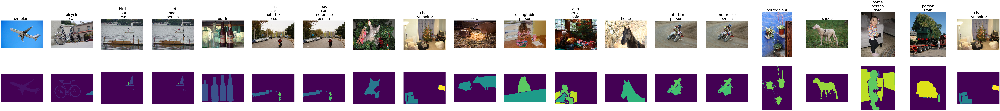

,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,"[[[10, 8, 13], [16, 14, 19], [17, 14, 21], [19...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."


In [2]:
# Loading the training data
train_df = pd.read_csv('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/train/train_set.csv', index_col="Id")
labels = train_df.columns
train_df["img"] = [np.load('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/train/img/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
train_df["seg"] = [np.load('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/train/seg/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
print("The training set contains {} examples.".format(len(train_df)))

# Show some examples
fig, axs = plt.subplots(2, 20, figsize=(10 * 20, 10 * 2))
for i, label in enumerate(labels):
    df = train_df.loc[train_df[label] == 1]
    axs[0, i].imshow(df.iloc[0]["img"], vmin=0, vmax=255)
    axs[0, i].set_title("\n".join(label for label in labels if df.iloc[0][label] == 1), fontsize=40)
    axs[0, i].axis("off")
    axs[1, i].imshow(df.iloc[0]["seg"], vmin=0, vmax=20)  # with the absolute color scale it will be clear that the arrays in the "seg" column are label maps (labels in [0, 20])
    axs[1, i].axis("off")
    
plt.show()
# The training dataframe contains for each image 20 columns with the ground truth classification labels and 20 column with the ground truth segmentation maps for each class
train_df.head(1)

In [3]:
# Loading the test data
test_df = pd.read_csv('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/test/test_set.csv', index_col="Id")
test_df["img"] = [np.load('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/test/img/test_{}.npy'.format(idx)) for idx, _ in test_df.iterrows()]
test_df["seg"] = [-1 * np.ones(img.shape[:2], dtype=np.int8) for img in test_df["img"]]
print("The test set contains {} examples.".format(len(test_df)))

# The test dataframe is similar to the training dataframe, but here the values are -1 --> your task is to fill in these as good as possible in Sect. 2 and Sect. 3; in Sect. 6 this dataframe is automatically transformed in the submission CSV!
test_df.head(1)

The test set contains 750 examples.


,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,-1,-1,-1,-1,-1,-1,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, ..."


## 1.3 Your Kaggle submission
Your filled test dataframe (during Sect. 2 and Sect. 3) must be converted to a submission.csv with two rows per example (one for classification and one for segmentation) and with only a single prediction column (the multi-class/label predictions running length encoded). You don't need to edit this section. Just make sure to call this function at the right position in this notebook.

In [4]:
def _rle_encode(img):
    """
    Kaggle requires RLE encoded predictions for computation of the Dice score (https://www.kaggle.com/lifa08/run-length-encode-and-decode)

    Parameters
    ----------
    img: np.ndarray - binary img array
    
    Returns
    -------
    rle: String - running length encoded version of img
    """
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    rle = ' '.join(str(x) for x in runs)
    return rle

def generate_submission(df):
    """
    Make sure to call this function once after you completed Sect. 2 and Sect. 3! It transforms and writes your test dataframe into a submission.csv file.
    
    Parameters
    ----------
    df: pd.DataFrame - filled dataframe that needs to be converted
    
    Returns
    -------
    submission_df: pd.DataFrame - df in submission format.
    """
    df_dict = {"Id": [], "Predicted": []}
    for idx, _ in df.iterrows():
        df_dict["Id"].append(f"{idx}_classification")
        df_dict["Predicted"].append(_rle_encode(np.array(df.loc[idx, labels])))
        df_dict["Id"].append(f"{idx}_segmentation")
        df_dict["Predicted"].append(_rle_encode(np.array([df.loc[idx, "seg"] == j + 1 for j in range(len(labels))])))
    
    submission_df = pd.DataFrame(data=df_dict, dtype=str).set_index("Id")
    submission_df.to_csv("submission.csv")
    return submission_df

# 2. Image classification
The goal here is simple: implement a classification CNN and train it to recognise all 20 classes (and/or background) using the training set and compete on the test set (by filling in the classification columns in the test dataframe).

In [5]:
class RandomClassificationModel:
    """
    Random classification model: 
        - generates random labels for the inputs based on the class distribution observed during training
        - assumes an input can have multiple labels
    """
    def fit(self, X, y):
        """
        Adjusts the class ratio variable to the one observed in y. 

        Parameters
        ----------
        X: list of arrays - n x (height x width x 3)
        y: list of arrays - n x (nb_classes)

        Returns
        -------
        self
        """
        self.distribution = np.mean(y, axis=0)
        print("Setting class distribution to:\n{}".format("\n".join(f"{label}: {p}" for label, p in zip(labels, self.distribution))))
        return self
        
    def predict(self, X):
        """
        Predicts for each input a label.
        
        Parameters
        ----------
        X: list of arrays - n x (height x width x 3)
            
        Returns
        -------
        y_pred: list of arrays - n x (nb_classes)
        """
        np.random.seed(0)
        return [np.array([int(np.random.rand() < p) for p in self.distribution]) for _ in X]
    
    def __call__(self, X):
        return self.predict(X)
    
model = RandomClassificationModel()
model.fit(train_df["img"], train_df[labels])
test_df.loc[:, labels] = model.predict(test_df["img"])
test_df.head(1)

Setting class distribution to:
aeroplane: 0.06275033377837116
bicycle: 0.0520694259012016
bird: 0.07343124165554073
boat: 0.06408544726301736
bottle: 0.056074766355140186
bus: 0.050734312416555405
car: 0.08411214953271028
cat: 0.06008010680907877
chair: 0.09212283044058744
cow: 0.04005340453938585
diningtable: 0.06408544726301736
dog: 0.05740987983978638
horse: 0.056074766355140186
motorbike: 0.06275033377837116
person: 0.27636849132176233
pottedplant: 0.05740987983978638
sheep: 0.036048064085447265
sofa: 0.05874499332443257
train: 0.0534045393858478
tvmonitor: 0.06809078771695594


,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,0,0,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, ..."


# 3. Semantic segmentation
The goal here is to implement a segmentation CNN that labels every pixel in the image as belonging to one of the 20 classes (and/or background). Use the training set to train your CNN and compete on the test set (by filling in the segmentation column in the test dataframe).

In [4]:
from keras import models
from keras import layers

from keras.models import Model, Sequential
from keras.layers import Dense, Flatten, Dropout, Input, LSTM, Dense, Conv2D, MaxPooling2D, Reshape, BatchNormalization, Activation, Conv2DTranspose, Add, ZeroPadding2D, Cropping2D, UpSampling2D

from keras.applications import VGG16
from keras.applications.vgg16 import preprocess_input, decode_predictions
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam, RMSprop, SGD
from keras.backend import argmax
from keras.utils import to_categorical
import cv2

from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras.callbacks import ModelCheckpoint, LearningRateScheduler, ReduceLROnPlateau, EarlyStopping
from keras import backend as keras
import keras.losses
from keras import regularizers #fixing overfitting with L2 regularization
import keras.backend as K
from keras.preprocessing.image import *
from skimage.transform import resize

In [5]:

train_df['img_n'] = train_df["img"].map(lambda img:  cv2.resize(img, (224,224)))
# train_df['segR'] = train_df["seg"].map(lambda img: np.expand_dims(img, -1))
#train_df['seg_n'] = np.zeros((749,224,224,1))
train_df["seg"] = train_df["seg"].map(lambda img:  cv2.resize(img, (224,224), interpolation=cv2.INTER_NEAREST))
# panda_df = pd.DataFrame(data=train_df['seg_n'])

In [6]:

train_img_keras = np.array(train_df["img_n"].values.tolist())
train_seg_keras = np.array(train_df["seg"].values.tolist())

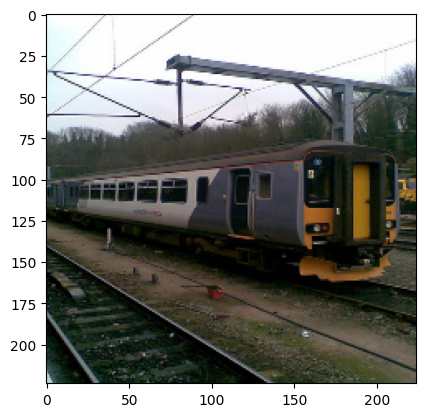

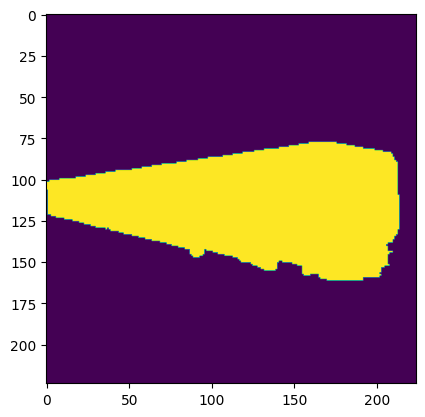

In [7]:
from sklearn.model_selection import train_test_split

# print(val_labels[100])

plt.figure()
plt.imshow(train_img_keras[10])
plt.show() 
plt.imshow(train_seg_keras[10])
#print(train_images.shape)

In [8]:
#train_df['seg_n'] = train_df['seg_n'].map(lambda img: to_categorical(img,num_classes=21))

X_train, X_test, y_train, y_test  = train_test_split(train_img_keras, train_seg_keras, test_size=0.2, random_state=1)
X_train, X_val, y_train, y_val  = train_test_split(X_train, y_train, test_size=0.2, random_state=1) # 0.25 x 0.8 = 0.2



In [9]:
print(X_train.shape)
print(y_train.reshape(-1, 224,224,1).shape)

(479, 224, 224, 3)
(479, 224, 224, 1)


In [10]:
def augment(input_image, input_mask):
   if tf.random.uniform(()) > 0.5:
      # Random flipping of the image and mask
      input_image = tf.image.flip_left_right(input_image)
      input_mask = tf.image.flip_left_right(input_mask)
   return input_image, input_mask

def normalize(input_image, input_mask):
   input_image = tf.cast(input_image, tf.float32) / 255.0
   # input_mask -= 1
   return input_image, input_mask

In [11]:
train_images_bc, train_labels_bc = (X_train, y_train.reshape(-1, 224,224,1))
train_labels_cat = to_categorical(train_labels_bc, num_classes=21)
train_images, train_labels = normalize(train_images_bc, train_labels_cat)
val_labels_cat = to_categorical(y_val, num_classes=21)
val_images, val_labels_cat = normalize(X_val, val_labels_cat)
test_labels_cat = to_categorical(y_test, num_classes=21)
test_images, test_labels_cat = normalize(X_test, test_labels_cat)

In [14]:
print(train_labels_cat.shape)

(479, 224, 224, 21)


In [15]:
train_labels_cat[10][0][0]
# train_images[10][160][52]
# # [0.38039216*255, 0.4392157*255, 0.4627451*255 ]
# [0.8784314*255 , 0.972549*255  , 0.84705883*255]

array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0.], dtype=float32)

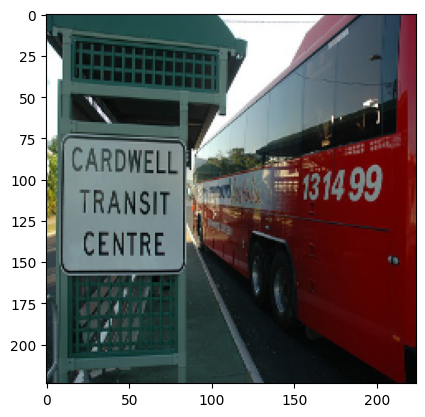

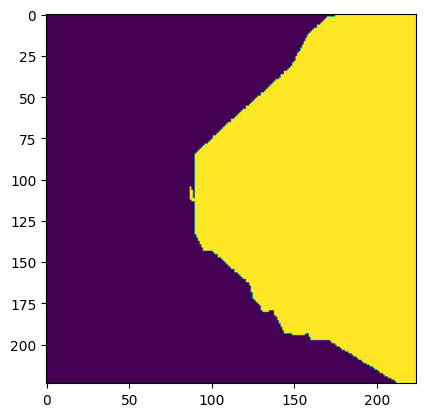

[0 6]


In [16]:
plt.figure()
plt.imshow(val_images[10])
plt.show()

plt.figure()
plt.imshow(np.argmax(val_labels_cat[10], axis=2))
plt.show()

print(np.unique(np.argmax(val_labels_cat[10], axis=2)))


In [17]:
#double 3x3 convolution 
def double_conv_block(x, n_filters):
    # Conv2D then ReLU activation
    x = Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
    # Conv2D then ReLU activation
    x = Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
    return x


def downsample_block(x, n_filters, dropout=0):
    f = double_conv_block(x, n_filters)
    p = MaxPooling2D((2, 2))(f)
    p = Dropout(dropout)(p)
    return f, p

def upsample_block(x, conv_features, n_filters, dropout=0):
    # upsample
    x = Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
    # concatenate
    x = concatenate([x, conv_features])
    # dropout
    x = Dropout(dropout)(x)
    # Conv2D twice with ReLU activation
    x = double_conv_block(x, n_filters)
    return x

def unet(pretrained_weights = None, input_size = (224,224,3), weights= [1.,1.,1.,1.],\
         activation='relu', dropout=0, loss='categorical_crossentropy', optimizer='adam',\
             dilation_rate=(1,1), reg=0.01):
    inputs  = Input(shape=input_size)
    #s = Lambda(lambda x: x / 255) (inputs)
    # encoder: contracting path - downsample
    # 1 - downsample
    f1, p1 = downsample_block(inputs, 64)
    # 2 - downsample
    f2, p2 = downsample_block(p1, 128)
    # 3 - downsample
    f3, p3 = downsample_block(p2, 256)
    # 4 - downsample
    f4, p4 = downsample_block(p3, 512)
    # 5 - bottleneck
    bottleneck = double_conv_block(p4, 1024)
    # decoder: expanding path - upsample
    # 6 - upsample
    u6 = upsample_block(bottleneck, f4, 512)
    # 7 - upsample
    u7 = upsample_block(u6, f3, 256)
    # 8 - upsample
    u8 = upsample_block(u7, f2, 128)
    # 9 - upsample
    u9 = upsample_block(u8, f1, 64)
    # outputs
    outputs = Conv2D(21, 1, activation='softmax')(u9)
    # unet model with Keras Functional API
    unet_model = tf.keras.Model([inputs], [outputs], name="U-Net")
    # unet_model.compile(optimizer=optimizer, loss=loss, metrics = ['accuracy'])

    if(pretrained_weights):
        
        print('Using {0} pretrained weights'.format(pretrained_weights))
    
        unet_model.load_weights(pretrained_weights)

    return unet_model

In [18]:
new_model = unet()
opt = Adam(learning_rate=0.001)
loss = 'categorical_crossentropy'
metrics = ['categorical_accuracy']
epochs = 100
steps_per_epoch = 30
# new_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc'])
new_model.compile(optimizer=opt, loss=loss, metrics=metrics)
new_model.summary()


Model: "U-Net"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 224, 224, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 224, 224, 64  36928       ['conv2d[0][0]']                 
                                )                                                             

In [19]:
np.array(val_images[0]).shape


(224, 224, 3)

Model 1: Unet model from scratch using custom architecture
During training, this architecture leads to a large divergence between traininig and validation accuracy.
It results in pixels from one class being classified as multiple different classes.

In [20]:
history_scratch = new_model.fit(train_images, train_labels_cat, 
                        validation_data=(val_images, val_labels_cat), 
                        epochs=100, batch_size=32)

Epoch 1/100
15/15 [==============================] - 48s 2s/step - loss: 2.2105 - categorical_accuracy: 0.7039 - val_loss: 1.5410 - val_categorical_accuracy: 0.7458
Epoch 2/100
15/15 [==============================] - 11s 724ms/step - loss: 1.3734 - categorical_accuracy: 0.7866 - val_loss: 1.4579 - val_categorical_accuracy: 0.7459
Epoch 3/100
15/15 [==============================] - 11s 736ms/step - loss: 1.2940 - categorical_accuracy: 0.7866 - val_loss: 1.4434 - val_categorical_accuracy: 0.7459
Epoch 4/100
15/15 [==============================] - 11s 754ms/step - loss: 1.2101 - categorical_accuracy: 0.7866 - val_loss: 1.3243 - val_categorical_accuracy: 0.7459
Epoch 5/100
15/15 [==============================] - 11s 717ms/step - loss: 1.1198 - categorical_accuracy: 0.7866 - val_loss: 1.2354 - val_categorical_accuracy: 0.7459
Epoch 6/100
15/15 [==============================] - 11s 754ms/step - loss: 1.0867 - categorical_accuracy: 0.7866 - val_loss: 1.2321 - val_categorical_accuracy: 0.

In [22]:
print(history_scratch.history.keys())

dict_keys(['loss', 'categorical_accuracy', 'val_loss', 'val_categorical_accuracy'])


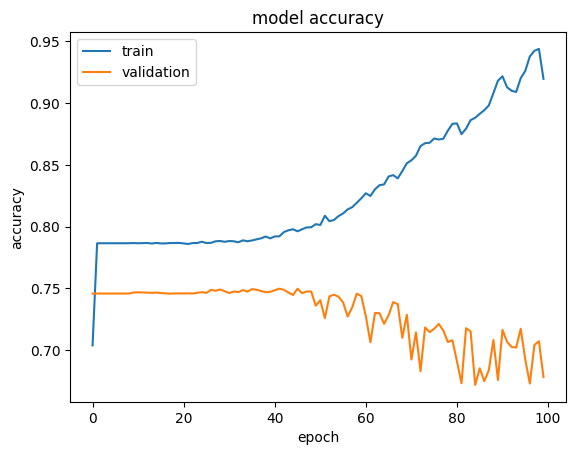

In [23]:
import matplotlib.pyplot as plt
plt.plot(history_scratch.history['categorical_accuracy'])
plt.plot(history_scratch.history['val_categorical_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

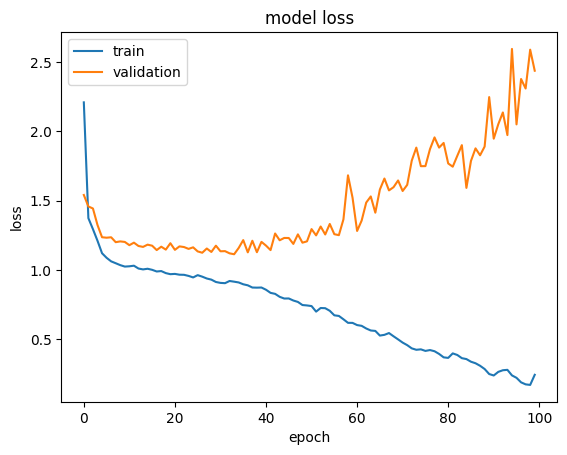

In [24]:
plt.plot(history_scratch.history['loss'])
plt.plot(history_scratch.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

1/1 [==============================] - 1s 920ms/step
[ 0  1  3  8 10 11 12 16 17]
[ 0 15]
1/1 [==============================] - 0s 22ms/step
[ 0  1  7  9 11 19]
[0 6 7]
1/1 [==============================] - 0s 21ms/step
[ 0  1  4  5  9 15 20]
[0 1]
1/1 [==============================] - 0s 22ms/step
[ 0  1  3  4  5  9 10 11 12 14 15 16 17 20]
[0 2 7]
1/1 [==============================] - 0s 21ms/step
[ 0  3  8 12 14 15 17]
[ 0 13]
1/1 [==============================] - 0s 21ms/step
[ 0  1  2  3  4  9 10 11 12 15 16 17 18 20]
[ 0  9 20]


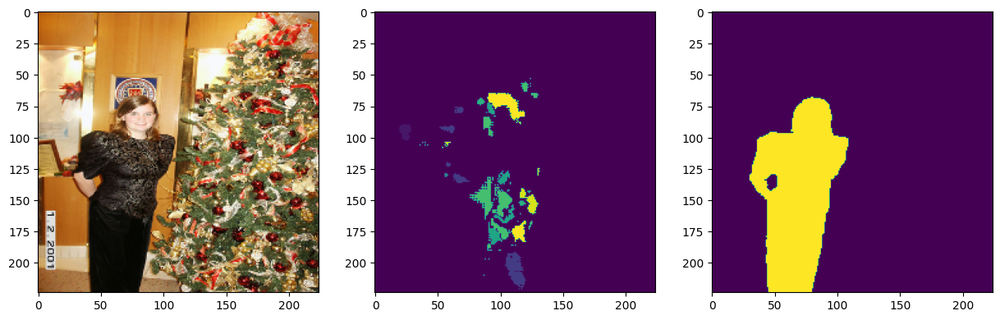

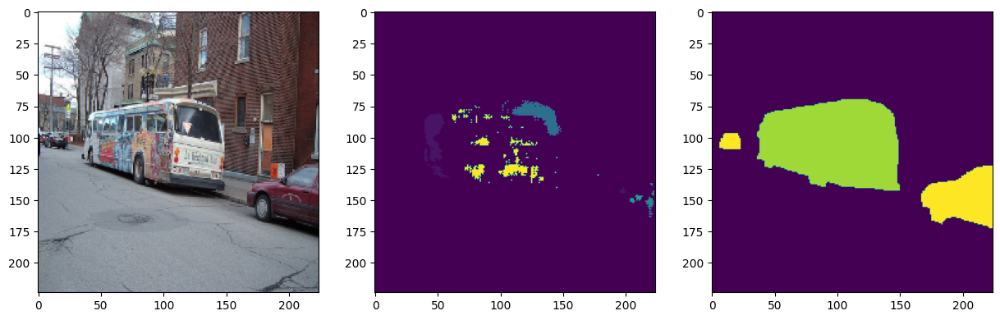

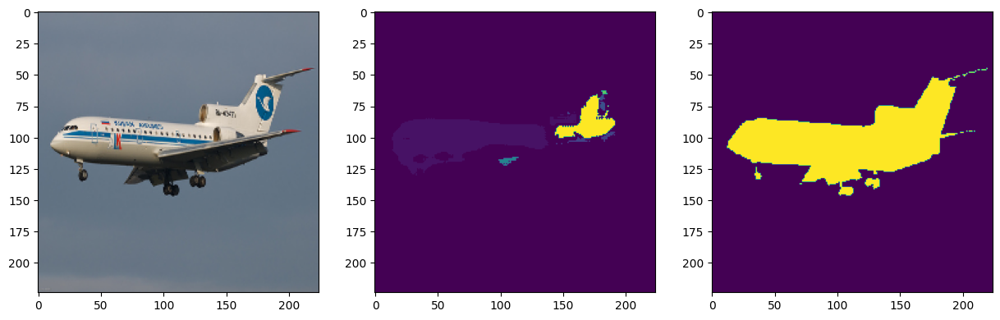

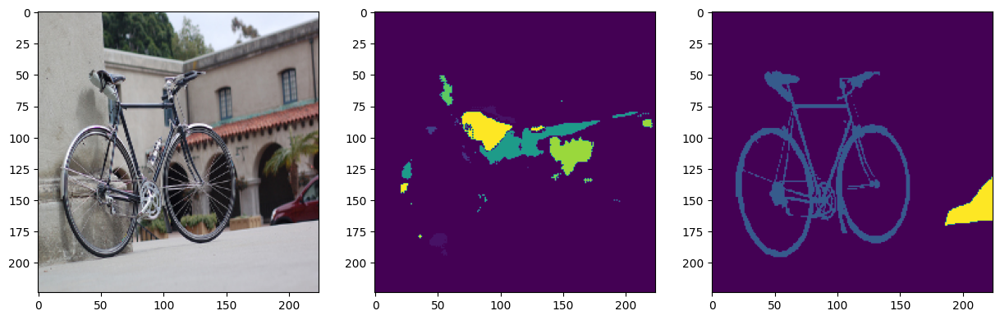

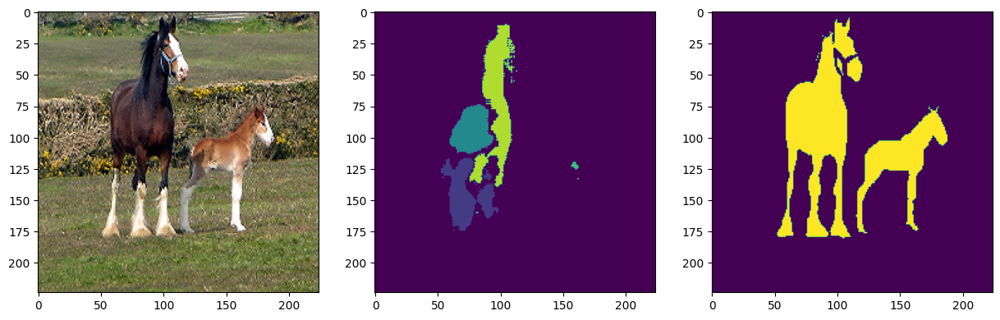

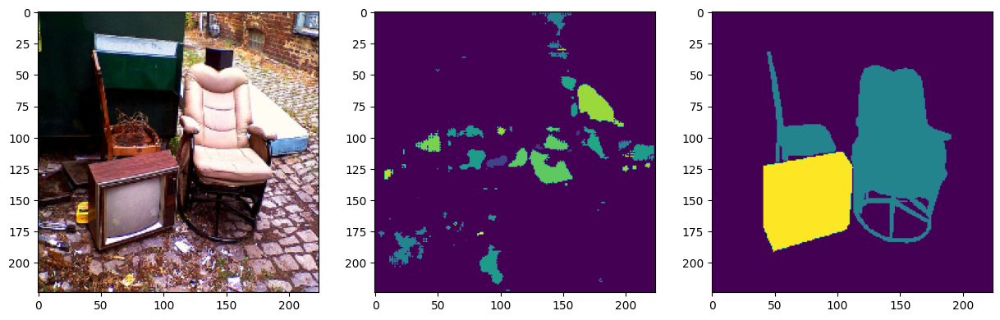

In [25]:
def test(img, i):
    x=img.reshape(-1,224,224,3)
    d =new_model.predict(x)
    result=d>0.55# setting the threshold
    imclass = np.argmax(result, axis=3)[0,:,:]
    print(np.unique(imclass))
    plt.figure(figsize = (15, 7))
    plt.subplot(1,3,1)
    plt.imshow( np.asarray(img) )
    plt.subplot(1,3,2)
    plt.imshow( imclass )
    plt.subplot(1,3,3)
    plt.imshow( np.asarray(img) )
    masked_imclass = np.ma.masked_where(imclass == 0, imclass)
    #plt.imshow( imclass, alpha=0.5 )
    #plt.imshow( masked_imclass, alpha=0.5 )
    # test_labels = train_labels_cat.reshape(224,224)
    #real_class = np.argmax(test_labels[25], axis=3)[0,:,:]
    print(np.unique(np.argmax(test_labels_cat[i], axis=2)))
    plt.imshow(np.argmax(test_labels_cat[i], axis=2))

test(np.asarray(test_images[1]),1)
test(np.asarray(test_images[12]),12)
test(np.asarray(test_images[33]),33)
test(np.asarray(test_images[14]),14)
test(np.asarray(test_images[22]),22)
test(np.asarray(test_images[31]),31)

In [26]:
new_model.save_weights('unet_segmentation_weights.h5')

Model 2: Unet model from scratch using predefined keras unet architecture
During training, this training accuracy slowly/steadily improves. I would like to experiment with less and more epochs to determine the effect on overall performance.

In [27]:
!pip install -U -q segmentation-models
#!pip install -q tensorflow==2.1
#!pip install -q keras==2.5
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"

from tensorflow import keras
#import segmentation_models as sm

import segmentation_models
from segmentation_models import Unet
from segmentation_models.utils import set_trainable

#base_model = VGG16(include_top=False, weights='imagenet',input_shape=(224, 224, 3))
#base_model.trainable=False

transfer_model = Unet(classes=21)
transfer_model.trainable = True
transfer_model.compile('Adam', 'categorical_crossentropy', ['categorical_accuracy'])

#train_images, train_labels_cat, 
#                        validation_data=(val_images, val_labels_cat), 
#                        epochs=125, batch_size=32

# pretrain model decoder
#transfer_model.fit(train_images, train_labels_cat, validation_data=(val_images, val_labels_cat), epochs=5, batch_size=32)

# release all layers for training
#set_trainable(transfer_model) # set all layers trainable and recompile model

# continue training
history_unet_scratch = transfer_model.fit(train_images, train_labels_cat, validation_data=(val_images, val_labels_cat), epochs=85, batch_size=32)

Segmentation Models: using `tf.keras` framework.
58889256/58889256 [==============================] - 1s 0us/step
Epoch 1/85
15/15 [==============================] - 22s 649ms/step - loss: 2.8065 - categorical_accuracy: 0.2149 - val_loss: 43.8215 - val_categorical_accuracy: 0.0616
Epoch 2/85
15/15 [==============================] - 7s 465ms/step - loss: 1.7164 - categorical_accuracy: 0.6651 - val_loss: 3.1621 - val_categorical_accuracy: 0.7438
Epoch 3/85
15/15 [==============================] - 7s 460ms/step - loss: 1.1807 - categorical_accuracy: 0.7861 - val_loss: 2.1765 - val_categorical_accuracy: 0.7451
Epoch 4/85
15/15 [==============================] - 7s 455ms/step - loss: 1.0362 - categorical_accuracy: 0.7866 - val_loss: 2.3960 - val_categorical_accuracy: 0.7454
Epoch 5/85
15/15 [==============================] - 6s 408ms/step - loss: 1.0116 - categorical_accuracy: 0.7866 - val_loss: 9.4566 - val_categorical_accuracy: 0.7456
Epoch 6/85
15/15 [==============================] - 6s

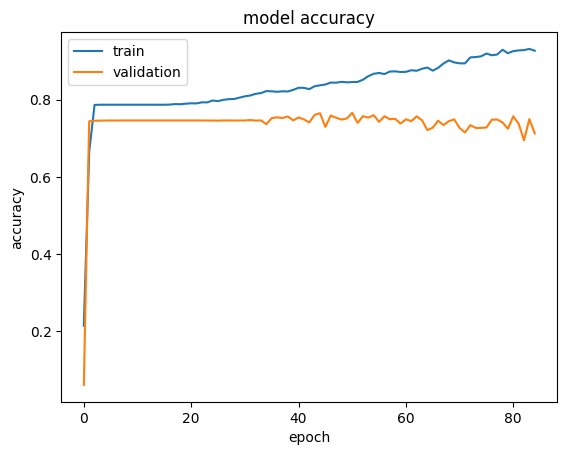

In [28]:
plt.plot(history_unet_scratch.history['categorical_accuracy'])
plt.plot(history_unet_scratch.history['val_categorical_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

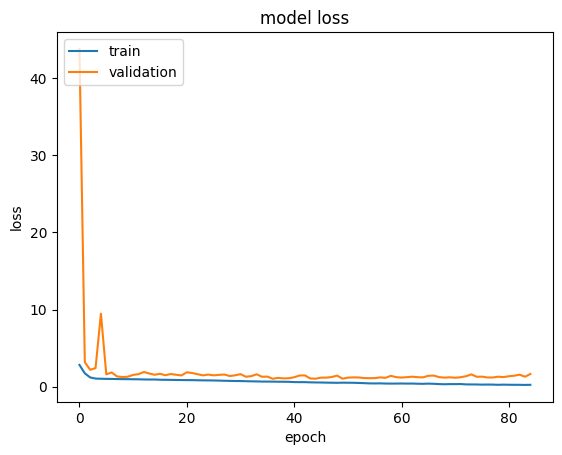

In [29]:
plt.plot(history_unet_scratch.history['loss'])
plt.plot(history_unet_scratch.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

1/1 [==============================] - 1s 593ms/step
[ 0  8  9 10 12 13]
[ 0 15]
1/1 [==============================] - 0s 22ms/step
[ 0  5  9 10 13]
[0 6 7]
1/1 [==============================] - 0s 24ms/step
[0 1 3 5 9]
[0 1]
1/1 [==============================] - 0s 22ms/step
[ 0  3  5  8 10 12 13 16]
[0 2 7]
1/1 [==============================] - 0s 22ms/step
[ 0  3  8 10 12 13 15]
[ 0 13]
1/1 [==============================] - 0s 22ms/step
[ 0  8  9 10 12 13]
[ 0  9 20]


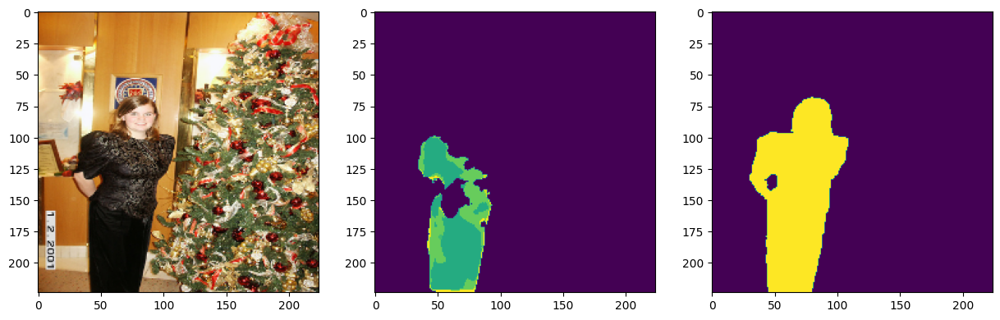

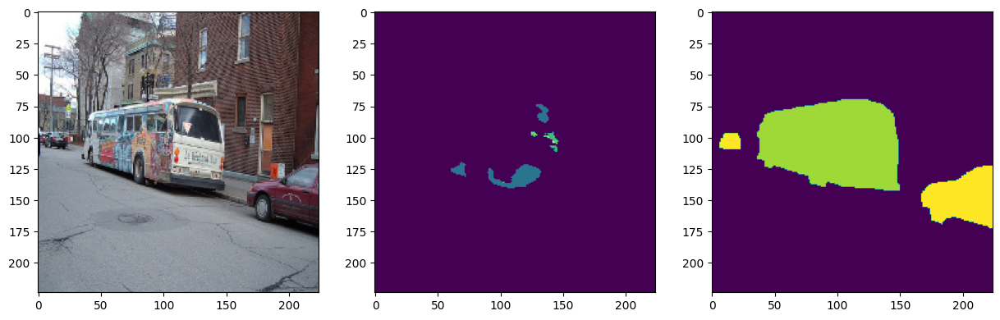

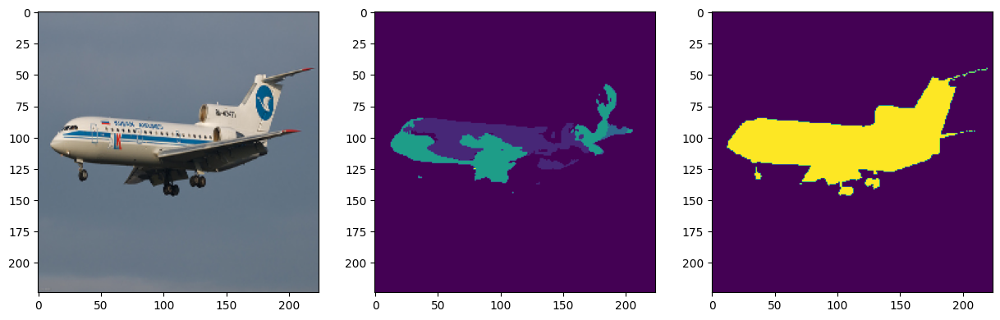

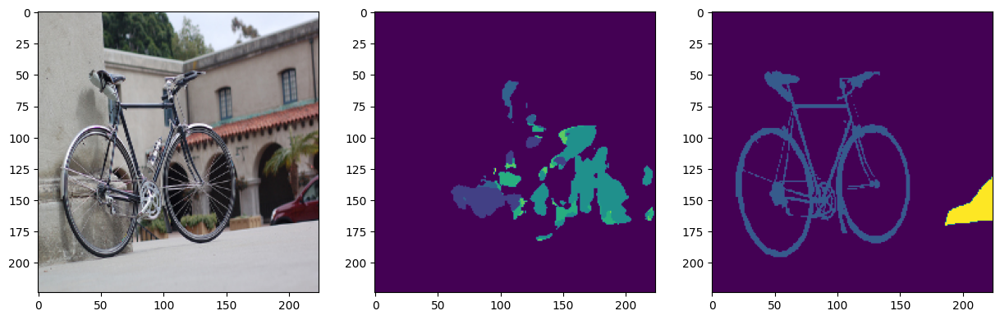

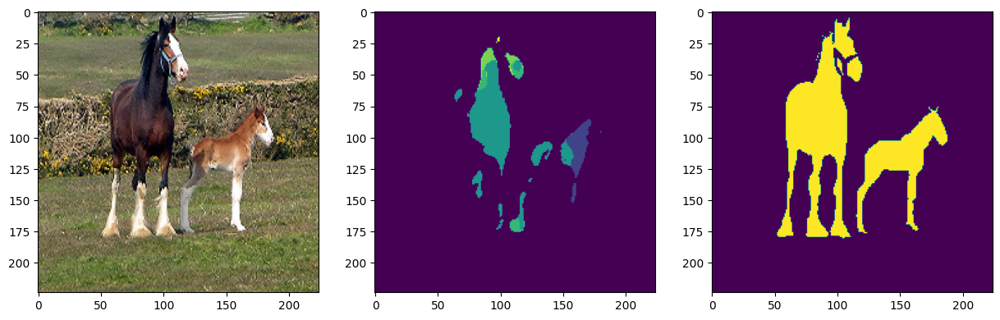

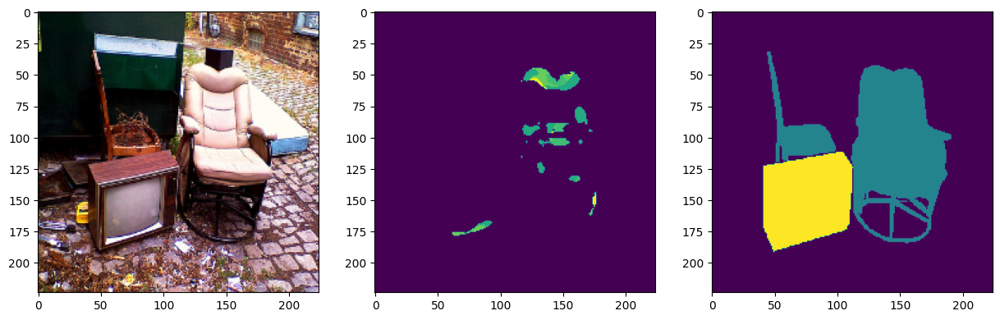

In [30]:
def test(img, i):
    x=img.reshape(-1,224,224,3)
    d =transfer_model.predict(x)
    result=d>0.55# setting the threshold
    imclass = np.argmax(result, axis=3)[0,:,:]
    print(np.unique(imclass))
    plt.figure(figsize = (15, 7))
    plt.subplot(1,3,1)
    plt.imshow( np.asarray(img) )
    plt.subplot(1,3,2)
    plt.imshow( imclass )
    plt.subplot(1,3,3)
    plt.imshow( np.asarray(img) )
    masked_imclass = np.ma.masked_where(imclass == 0, imclass)
    #plt.imshow( imclass, alpha=0.5 )
    #plt.imshow( masked_imclass, alpha=0.5 )
    # test_labels = train_labels_cat.reshape(224,224)
    #real_class = np.argmax(test_labels[25], axis=3)[0,:,:]
    print(np.unique(np.argmax(test_labels_cat[i], axis=2)))
    plt.imshow(np.argmax(test_labels_cat[i], axis=2))

test(np.asarray(test_images[1]),1)
test(np.asarray(test_images[12]),12)
test(np.asarray(test_images[33]),33)
test(np.asarray(test_images[14]),14)
test(np.asarray(test_images[22]),22)
test(np.asarray(test_images[31]),31)

In [31]:
print(transfer_model.summary())

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 block1_conv1 (Conv2D)          (None, None, None,   1792        ['input_2[0][0]']                
                                64)                                                               
                                                                                                  
 block1_conv2 (Conv2D)          (None, None, None,   36928       ['block1_conv1[0][0]']           
                                64)                                                           

Model 3: Unet model with pretrained model weights from keras
During training, this training accuracy *very* slowly improves. Some classes are not identified during testing (only background). However compared to the model trained from scratch, pixels from one object are not being classified as so many different classes anymore.  I would like to experiment with more epochs to determine the effect on overall performance.

In [12]:
!pip install -U -q segmentation-models
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"

from tensorflow import keras
#import segmentation_models as sm

import segmentation_models
from segmentation_models import Unet
from segmentation_models.utils import set_trainable

inp = Input(shape=(None, None, 21))
model = Unet(backbone_name='resnet34', classes=21, encoder_weights='imagenet')


#model = Model (inp, c3, name=base.name)
model.compile('Adam', 'binary_crossentropy', ['binary_accuracy'])


#l1 = Conv2D(3, (1, 1))(inp) # map N channels data to 3 channels
#out = base_model(l1)

#model = Model(inp, out, name=base_model.name)

# continue training
history_transfer = model.fit(train_images, train_labels_cat, validation_data=(val_images, val_labels_cat), epochs=72, batch_size=32)

Segmentation Models: using `tf.keras` framework.
85521592/85521592 [==============================] - 3s 0us/step
Epoch 1/72
15/15 [==============================] - 38s 576ms/step - loss: 0.5567 - binary_accuracy: 0.7863 - val_loss: 3.7238 - val_binary_accuracy: 0.6903
Epoch 2/72
15/15 [==============================] - 5s 330ms/step - loss: 0.2734 - binary_accuracy: 0.9708 - val_loss: 10.2292 - val_binary_accuracy: 0.9744
Epoch 3/72
15/15 [==============================] - 5s 332ms/step - loss: 0.1464 - binary_accuracy: 0.9796 - val_loss: 0.3286 - val_binary_accuracy: 0.9600
Epoch 4/72
15/15 [==============================] - 5s 334ms/step - loss: 0.1012 - binary_accuracy: 0.9796 - val_loss: 0.1776 - val_binary_accuracy: 0.9583
Epoch 5/72
15/15 [==============================] - 5s 321ms/step - loss: 0.0834 - binary_accuracy: 0.9797 - val_loss: 0.1710 - val_binary_accuracy: 0.9612
Epoch 6/72
15/15 [==============================] - 5s 332ms/step - loss: 0.0742 - binary_accuracy: 0.98

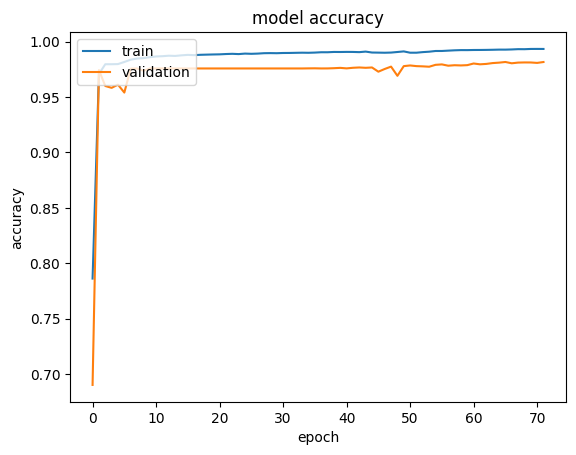

In [13]:
plt.plot(history_transfer.history['binary_accuracy'])
plt.plot(history_transfer.history['val_binary_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

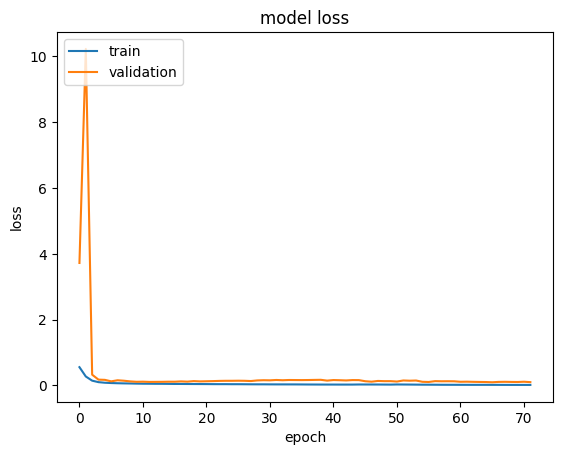

In [14]:
plt.plot(history_transfer.history['loss'])
plt.plot(history_transfer.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

1/1 [==============================] - 1s 930ms/step
[ 0 15]
[ 0 15]
1/1 [==============================] - 0s 25ms/step
[ 0 19]
[0 6 7]
1/1 [==============================] - 0s 75ms/step
[0]
[0 1]
1/1 [==============================] - 0s 26ms/step
[0]
[0 2 7]
1/1 [==============================] - 0s 25ms/step
[ 0 13 15]
[ 0 13]
1/1 [==============================] - 0s 25ms/step
[ 0 15]
[ 0  9 20]


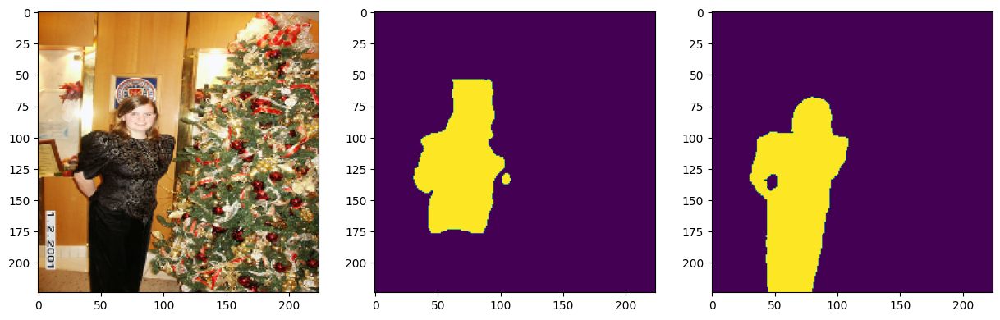

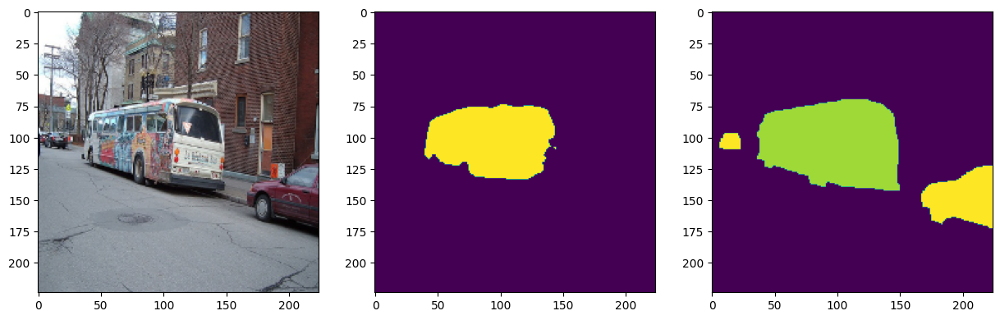

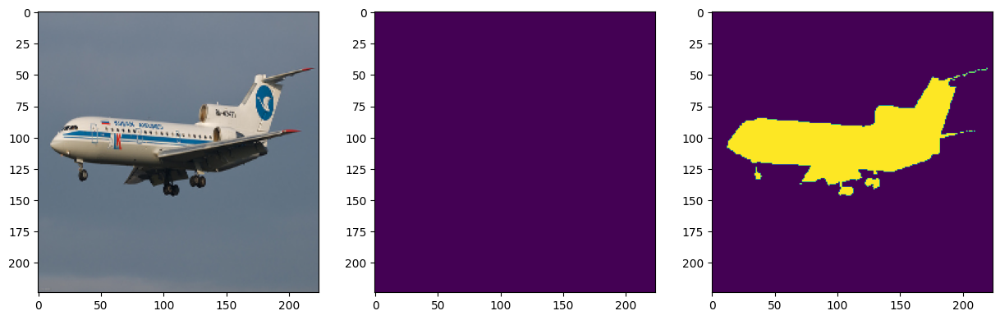

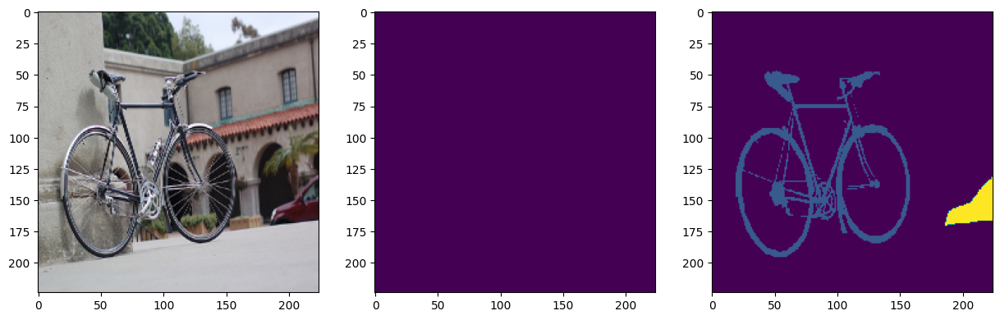

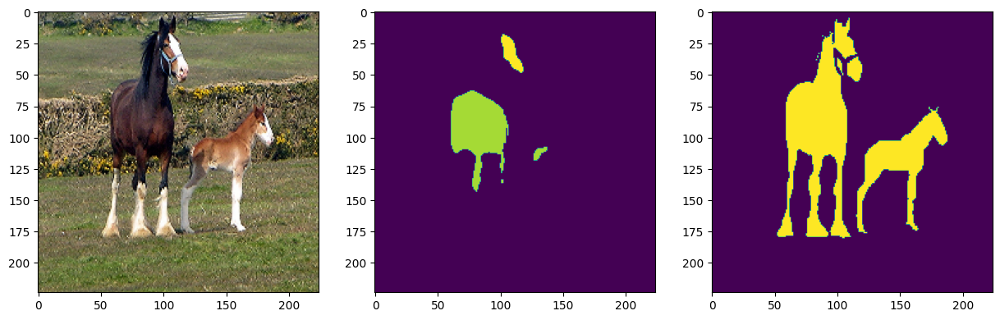

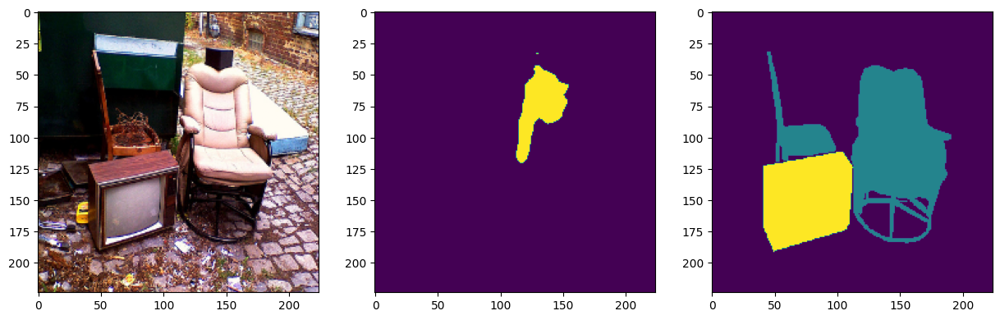

In [15]:
def test(img, i):
    x=img.reshape(-1,224,224,3)
    d =model.predict(x)
    result=d>0.55# setting the threshold
    imclass = np.argmax(result, axis=3)[0,:,:]
    print(np.unique(imclass))
    plt.figure(figsize = (15, 7))
    plt.subplot(1,3,1)
    plt.imshow( np.asarray(img) )
    plt.subplot(1,3,2)
    plt.imshow( imclass )
    plt.subplot(1,3,3)
    plt.imshow( np.asarray(img) )
    masked_imclass = np.ma.masked_where(imclass == 0, imclass)
    #plt.imshow( imclass, alpha=0.5 )
    #plt.imshow( masked_imclass, alpha=0.5 )
    # test_labels = train_labels_cat.reshape(224,224)
    #real_class = np.argmax(test_labels[25], axis=3)[0,:,:]
    print(np.unique(np.argmax(test_labels_cat[i], axis=2)))
    plt.imshow(np.argmax(test_labels_cat[i], axis=2))

test(np.asarray(test_images[1]),1)
test(np.asarray(test_images[12]),12)
test(np.asarray(test_images[33]),33)
test(np.asarray(test_images[14]),14)
test(np.asarray(test_images[22]),22)
test(np.asarray(test_images[31]),31)

Model 4: Unet model trained from scratch using keras predefined architecture.
This is the same as model 2, except I experimented with binary_accuracy/binary_crossentropy instead of categorical. It results in a lot of only background predictions.

In [16]:
transfer_model_binary = Unet(classes=21)
transfer_model_binary.trainable = True
transfer_model_binary.compile('Adam', 'binary_crossentropy', ['binary_accuracy'])

# training
history_unet_transfer_binary = transfer_model_binary.fit(train_images, train_labels_cat, validation_data=(val_images, val_labels_cat), epochs=85, batch_size=32)

58889256/58889256 [==============================] - 3s 0us/step
Epoch 1/85
15/15 [==============================] - 31s 1s/step - loss: 0.5319 - binary_accuracy: 0.7686 - val_loss: 0.2048 - val_binary_accuracy: 0.9470
Epoch 2/85
15/15 [==============================] - 7s 477ms/step - loss: 0.2649 - binary_accuracy: 0.9568 - val_loss: 0.2061 - val_binary_accuracy: 0.9755
Epoch 3/85
15/15 [==============================] - 7s 467ms/step - loss: 0.1479 - binary_accuracy: 0.9793 - val_loss: 0.2163 - val_binary_accuracy: 0.9757
Epoch 4/85
15/15 [==============================] - 6s 427ms/step - loss: 0.1070 - binary_accuracy: 0.9797 - val_loss: 0.1749 - val_binary_accuracy: 0.9758
Epoch 5/85
15/15 [==============================] - 7s 486ms/step - loss: 0.0917 - binary_accuracy: 0.9797 - val_loss: 0.1988 - val_binary_accuracy: 0.9754
Epoch 6/85
15/15 [==============================] - 7s 480ms/step - loss: 0.0842 - binary_accuracy: 0.9798 - val_loss: 0.1764 - val_binary_accuracy: 0.9647
E

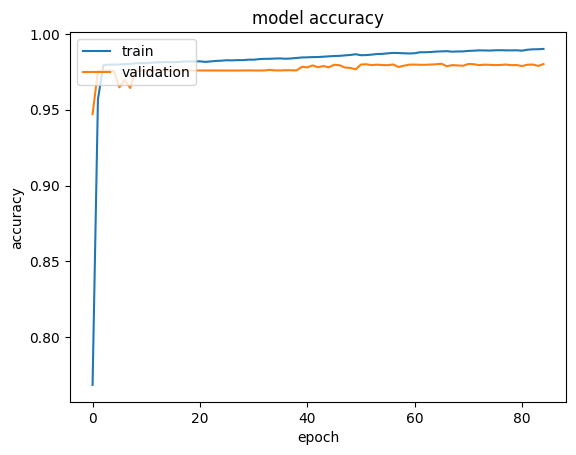

In [17]:
plt.plot(history_unet_transfer_binary.history['binary_accuracy'])
plt.plot(history_unet_transfer_binary.history['val_binary_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

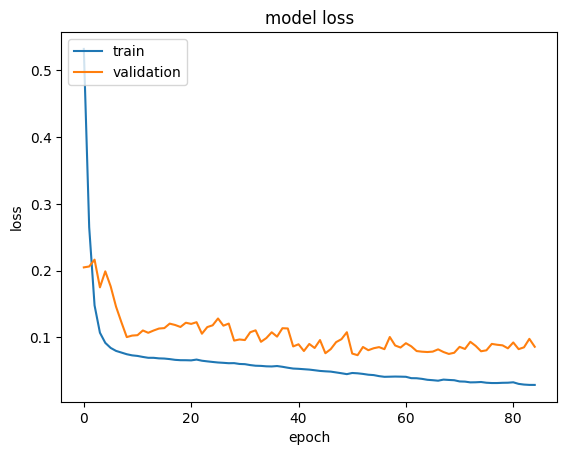

In [18]:
plt.plot(history_unet_transfer_binary.history['loss'])
plt.plot(history_unet_transfer_binary.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

1/1 [==============================] - 1s 612ms/step
[0]
[ 0 15]
1/1 [==============================] - 0s 23ms/step
[0]
[0 6 7]
1/1 [==============================] - 0s 27ms/step
[0]
[0 1]
1/1 [==============================] - 0s 23ms/step
[0]
[0 2 7]
1/1 [==============================] - 0s 23ms/step
[ 0 15]
[ 0 13]
1/1 [==============================] - 0s 25ms/step
[ 0 15]
[ 0  9 20]


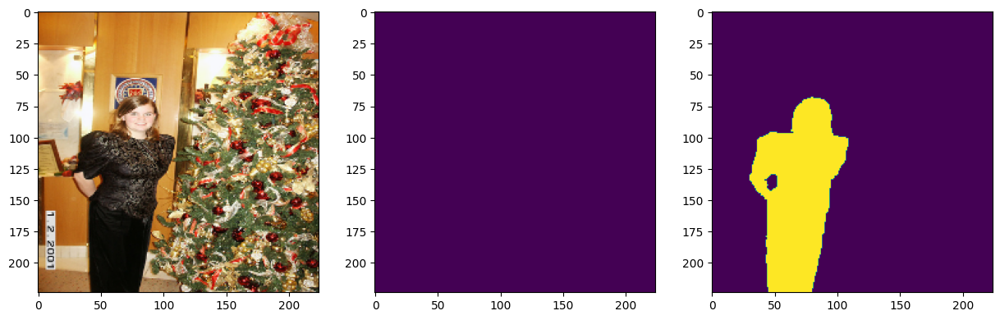

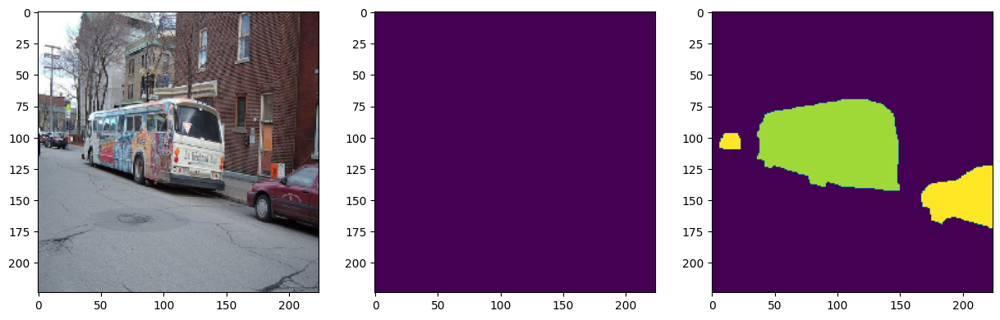

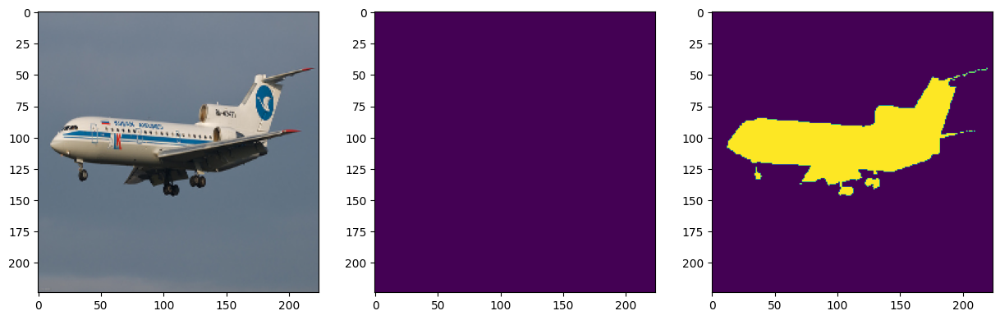

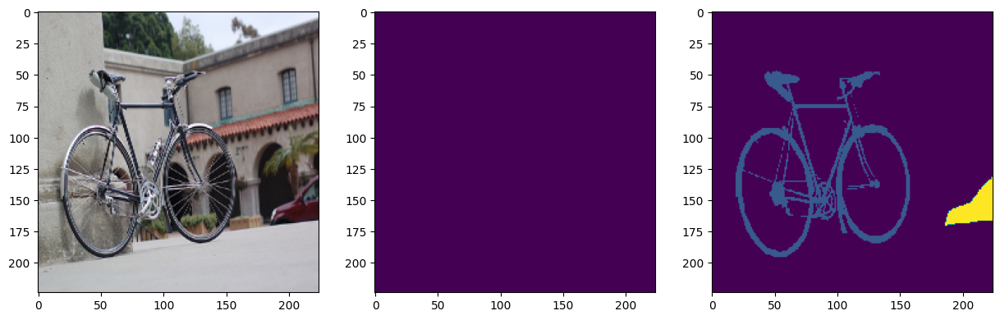

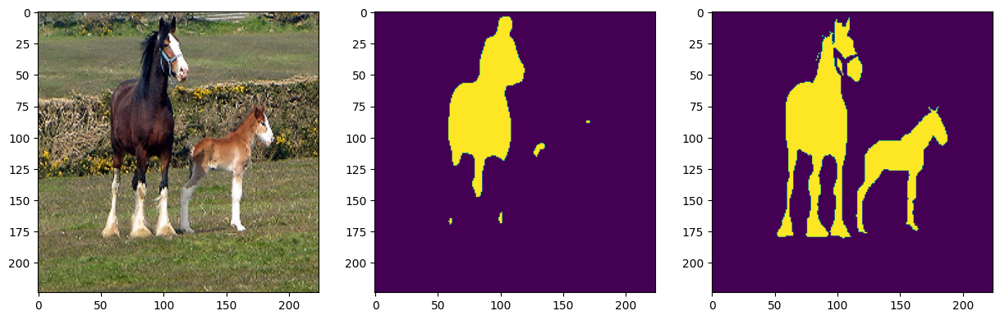

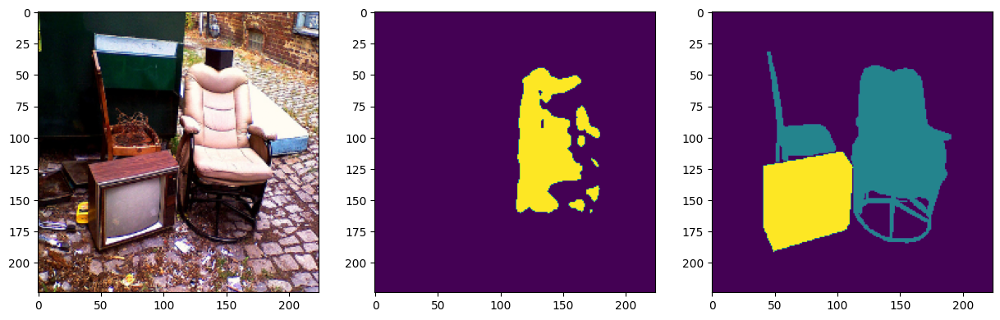

In [19]:
def test(img, i):
    x=img.reshape(-1,224,224,3)
    d =transfer_model_binary.predict(x)
    result=d>0.55# setting the threshold
    imclass = np.argmax(result, axis=3)[0,:,:]
    print(np.unique(imclass))
    plt.figure(figsize = (15, 7))
    plt.subplot(1,3,1)
    plt.imshow( np.asarray(img) )
    plt.subplot(1,3,2)
    plt.imshow( imclass )
    plt.subplot(1,3,3)
    plt.imshow( np.asarray(img) )
    masked_imclass = np.ma.masked_where(imclass == 0, imclass)
    #plt.imshow( imclass, alpha=0.5 )
    #plt.imshow( masked_imclass, alpha=0.5 )
    # test_labels = train_labels_cat.reshape(224,224)
    #real_class = np.argmax(test_labels[25], axis=3)[0,:,:]
    print(np.unique(np.argmax(test_labels_cat[i], axis=2)))
    plt.imshow(np.argmax(test_labels_cat[i], axis=2))
test(np.asarray(test_images[1]),1)
test(np.asarray(test_images[12]),12)
test(np.asarray(test_images[33]),33)
test(np.asarray(test_images[14]),14)
test(np.asarray(test_images[22]),22)
test(np.asarray(test_images[31]),31)

Model 5: Unet model with pretrained model weights from keras
This is the same as model 3 except I experimented with training for only 20 epochs. It results in only background predictions, so more than 20 epochs are definitely necessary.

In [20]:
model_less_epochs = Unet(backbone_name='resnet34', classes=21, encoder_weights='imagenet')


#model = Model (inp, c3, name=base.name)
model_less_epochs.compile('Adam', 'binary_crossentropy', ['binary_accuracy'])


#l1 = Conv2D(3, (1, 1))(inp) # map N channels data to 3 channels
#out = base_model(l1)

#model = Model(inp, out, name=base_model.name)

# continue training
history_transfer_less_epochs = model_less_epochs.fit(train_images, train_labels_cat, validation_data=(val_images, val_labels_cat), epochs=20, batch_size=32)

Epoch 1/20
15/15 [==============================] - 30s 504ms/step - loss: 0.5301 - binary_accuracy: 0.8014 - val_loss: 1.3554 - val_binary_accuracy: 0.9284
Epoch 2/20
15/15 [==============================] - 5s 332ms/step - loss: 0.2560 - binary_accuracy: 0.9725 - val_loss: 0.2914 - val_binary_accuracy: 0.9755
Epoch 3/20
15/15 [==============================] - 5s 339ms/step - loss: 0.1411 - binary_accuracy: 0.9797 - val_loss: 0.1705 - val_binary_accuracy: 0.9758
Epoch 4/20
15/15 [==============================] - 5s 326ms/step - loss: 0.0986 - binary_accuracy: 0.9797 - val_loss: 0.2499 - val_binary_accuracy: 0.9741
Epoch 5/20
15/15 [==============================] - 5s 344ms/step - loss: 0.0812 - binary_accuracy: 0.9824 - val_loss: 0.9406 - val_binary_accuracy: 0.9758
Epoch 6/20
15/15 [==============================] - 5s 337ms/step - loss: 0.0721 - binary_accuracy: 0.9839 - val_loss: 0.2232 - val_binary_accuracy: 0.9757
Epoch 7/20
15/15 [==============================] - 5s 336ms/st

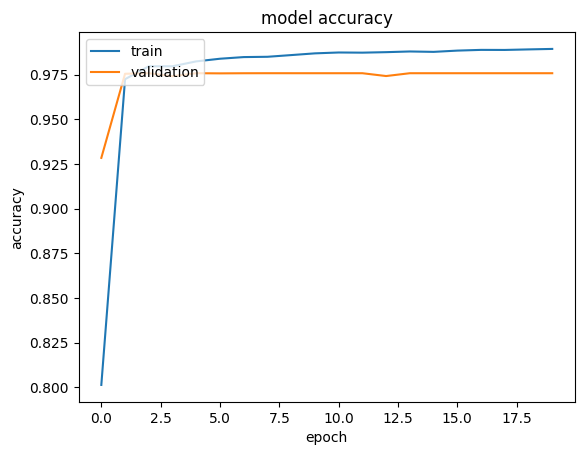

In [21]:
plt.plot(history_transfer_less_epochs.history['binary_accuracy'])
plt.plot(history_transfer_less_epochs.history['val_binary_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

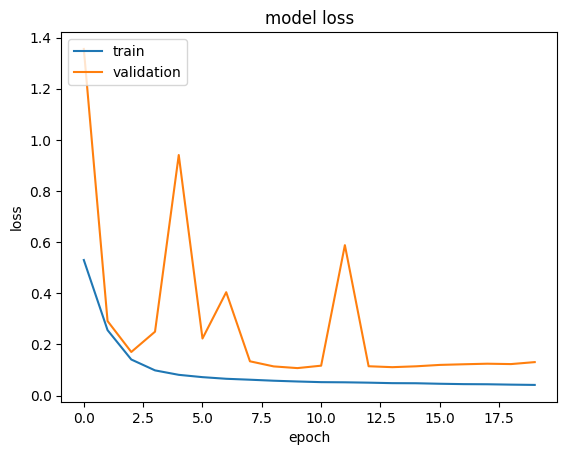

In [22]:
plt.plot(history_transfer_less_epochs.history['loss'])
plt.plot(history_transfer_less_epochs.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

1/1 [==============================] - 1s 750ms/step
[0]
[ 0 15]
1/1 [==============================] - 0s 26ms/step
[0]
[0 6 7]
1/1 [==============================] - 0s 27ms/step
[0]
[0 1]
1/1 [==============================] - 0s 25ms/step
[0]
[0 2 7]
1/1 [==============================] - 0s 27ms/step
[0]
[ 0 13]
1/1 [==============================] - 0s 25ms/step
[0]
[ 0  9 20]


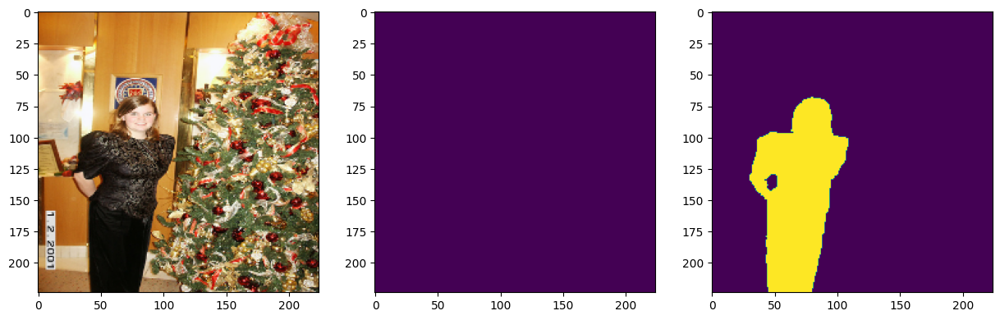

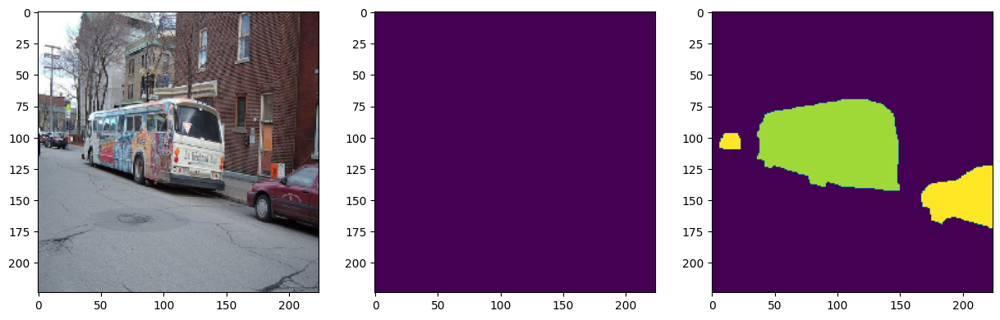

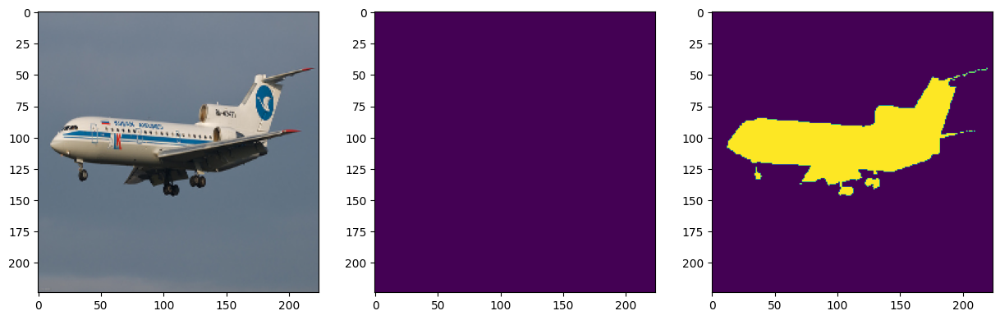

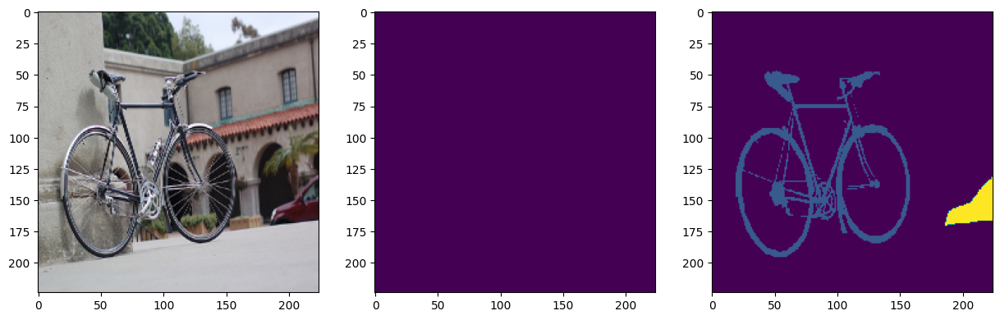

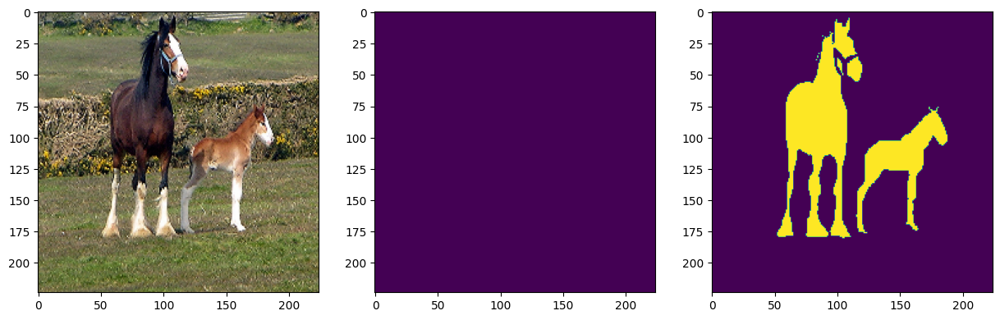

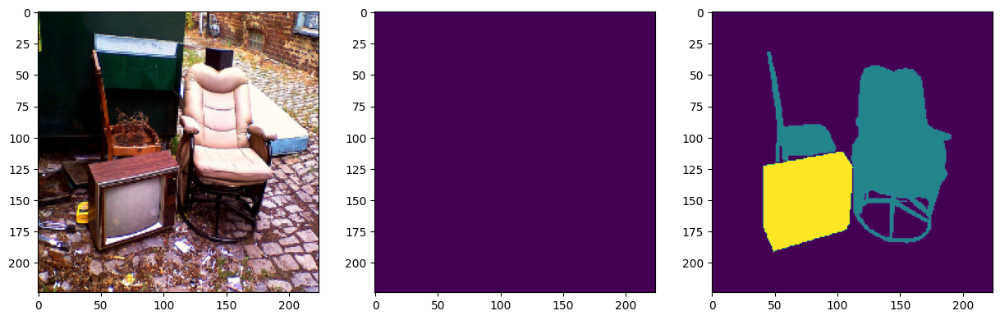

In [23]:
def test(img, i):
    x=img.reshape(-1,224,224,3)
    d =model_less_epochs.predict(x)
    result=d>0.55# setting the threshold
    imclass = np.argmax(result, axis=3)[0,:,:]
    print(np.unique(imclass))
    plt.figure(figsize = (15, 7))
    plt.subplot(1,3,1)
    plt.imshow( np.asarray(img) )
    plt.subplot(1,3,2)
    plt.imshow( imclass )
    plt.subplot(1,3,3)
    plt.imshow( np.asarray(img) )
    masked_imclass = np.ma.masked_where(imclass == 0, imclass)
    #plt.imshow( imclass, alpha=0.5 )
    #plt.imshow( masked_imclass, alpha=0.5 )
    # test_labels = train_labels_cat.reshape(224,224)
    #real_class = np.argmax(test_labels[25], axis=3)[0,:,:]
    print(np.unique(np.argmax(test_labels_cat[i], axis=2)))
    plt.imshow(np.argmax(test_labels_cat[i], axis=2))
test(np.asarray(test_images[1]),1)
test(np.asarray(test_images[12]),12)
test(np.asarray(test_images[33]),33)
test(np.asarray(test_images[14]),14)
test(np.asarray(test_images[22]),22)
test(np.asarray(test_images[31]),31)

## Submit to competition
You don't need to edit this section. Just use it at the right position in the notebook. See the definition of this function in Sect. 1.3 for more details.

In [ ]:
generate_submission(test_df)

# 4. Adversarial attack
For this part, your goal is to fool your classification and/or segmentation CNN, using an *adversarial attack*. More specifically, the goal is build a CNN to perturb test images in a way that (i) they look unperturbed to humans; but (ii) the CNN classifies/segments these images in line with the perturbations.

# 5. Discussion
Finally, take some time to reflect on what you have learned during this assignment. Reflect and produce an overall discussion with links to the lectures and "real world" computer vision.